In [68]:
import os
import matplotlib.pyplot as plt
from PIL import Image
import random

In [69]:
paths_style = [
    'Analysis/Early-Renaissance/style-based',
    'Analysis/Expressionism/style-based',
    'Analysis/Pop-Art/style-based',
]
paths_content = [
    'Analysis/Early-Renaissance/content-based',
    'Analysis/Expressionism/content-based',
    'Analysis/Pop-Art/content-based',
]
paths_edge = [
    'Analysis/Early-Renaissance/edge-cases',
    'Analysis/Expressionism/edge-case',
    'Analysis/Pop-Art/edge-cases',
]

In [70]:
def grid(folder_path):
    images = []
    descriptions = []

    for file_name in os.listdir(folder_path):
        if file_name.lower().endswith(('png', 'jpg', 'jpeg', 'gif', 'bmp')):
            file_path = os.path.join(folder_path, file_name)
            try:
                images.append(Image.open(file_path))
                descriptions.append(file_name)
            except Exception as e:
                print(f'Error loading {file_path}: {e}')

    if not images:
        print('No images found in the folder.')
        return

    grid_size = int(len(images) ** 0.5) + (1 if (len(images) ** 0.5) % 1 > 0 else 0)

    fig, axes = plt.subplots(grid_size, grid_size, figsize=(12, 12))
    axes = axes.flatten()

    for ax in axes[len(images) :]:
        ax.axis('off')

    for i, (img, desc) in enumerate(zip(images, descriptions)):
        ax = axes[i]
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(desc, fontsize=8, wrap=True)

    plt.tight_layout()
    plt.show()

STYLE BASED PROMPTS <br>
<br/><br/>
Early-Renaissance:<br>
<br/><br/>
„A woman, artistic, aesthetic, bright colors, bold colors, hard edges, mixed media, pop art.“<br> 
„ Dinner, artistic, aesthetic, bright colors, bold colors, hard edges, mixed media, pop art.“<br>
„A city, artistic, aesthetic,  bright colors, bold colors, hard edges, mixed media, pop art.“<br>
<br/><br/>
Expressionism:<br>
<br/><br/>
„A woman, artistic, Jagged brush,  Distortion, muddy colors, red, navies, swampy greens, yellow and blues for contrast, expressionism.<br>
„ Dinner, swirling brush strokes, muddy colors, red, navies, swampy greens, yellow and blues for contrast, expressionism.“<br>
„A city, artistic, aesthetic,   muddy colors, red, navies, swampy greens, yellow and blues for contrast, expressionism.““<br>

<br/><br/>
Pop-Art:<br>
<br/><br/>
„A woman, artistic, aesthetic, bright colors, bold colors, hard edges, mixed media, pop art.“<br>
„ Dinner, artistic, aesthetic, bright colors, bold colors, hard edges, mixed media, pop art.“ <br>
„A city, artistic, aesthetic,  bright colors, bold colors, hard edges, mixed media, pop art.“<br>

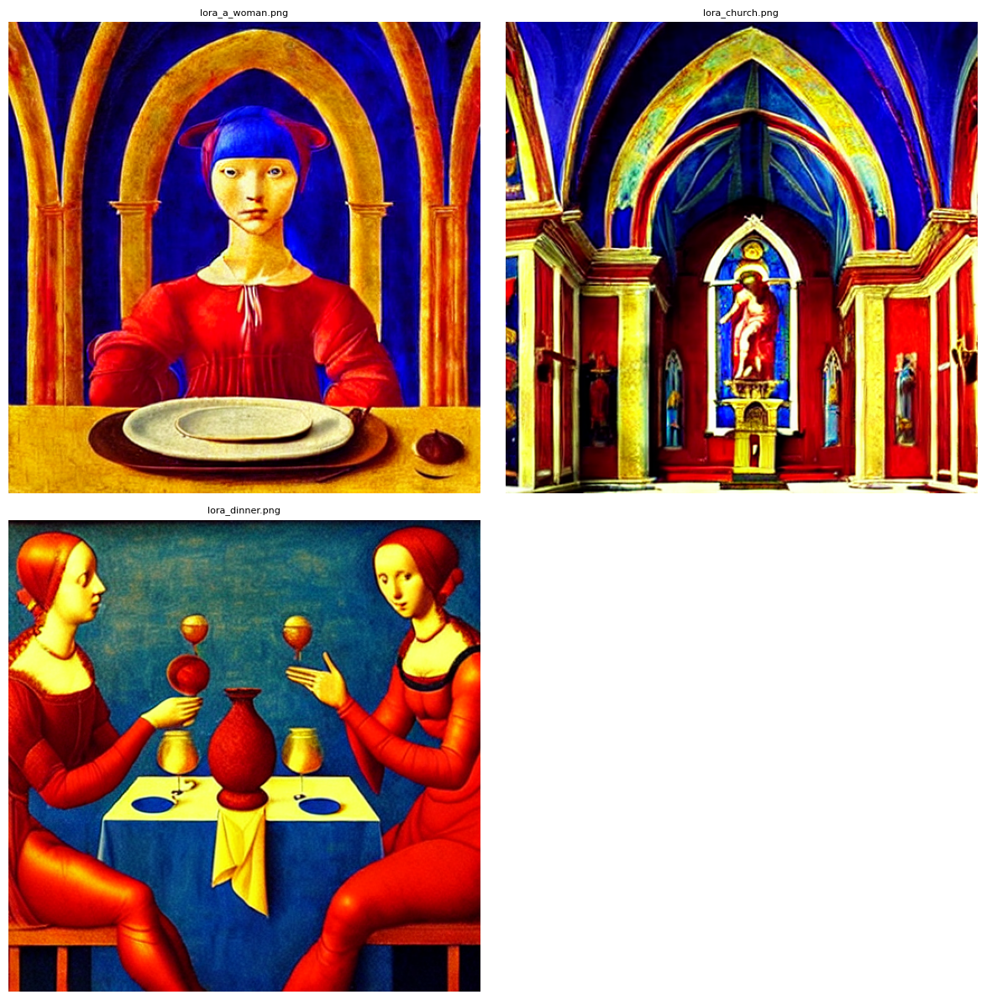

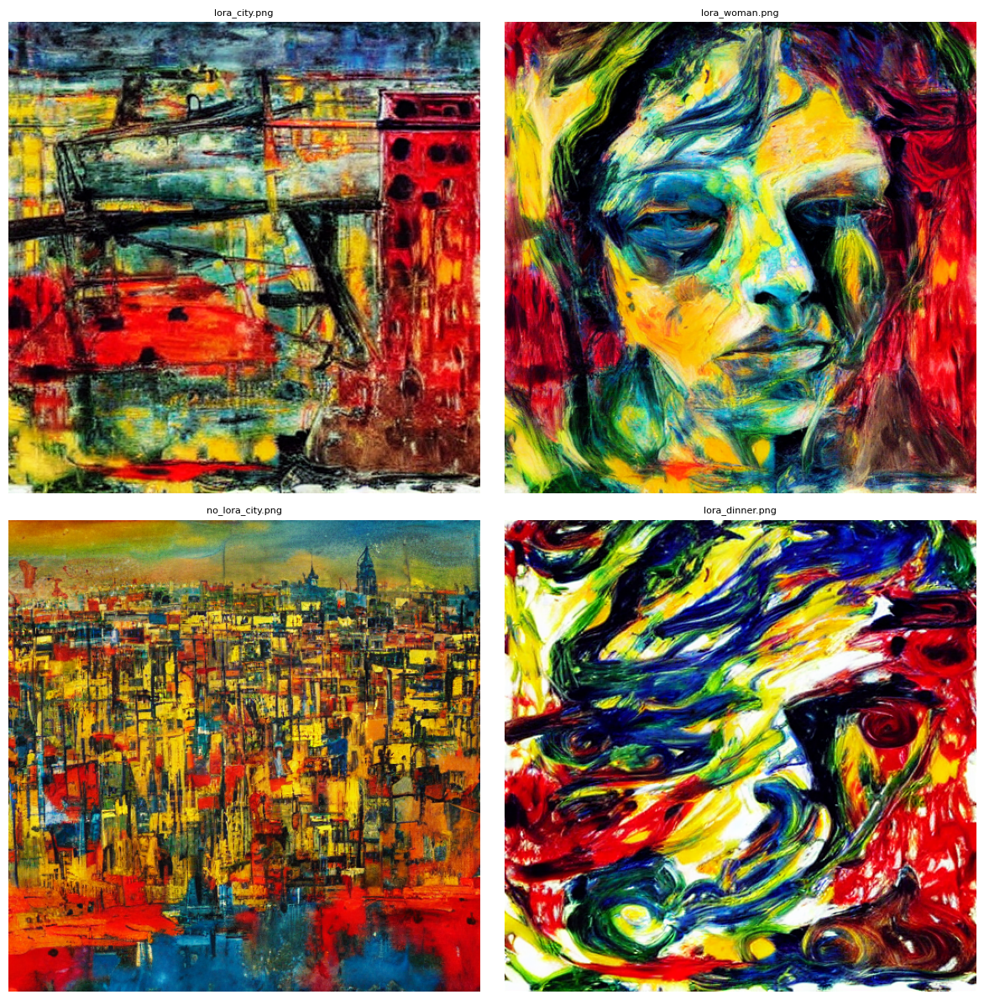

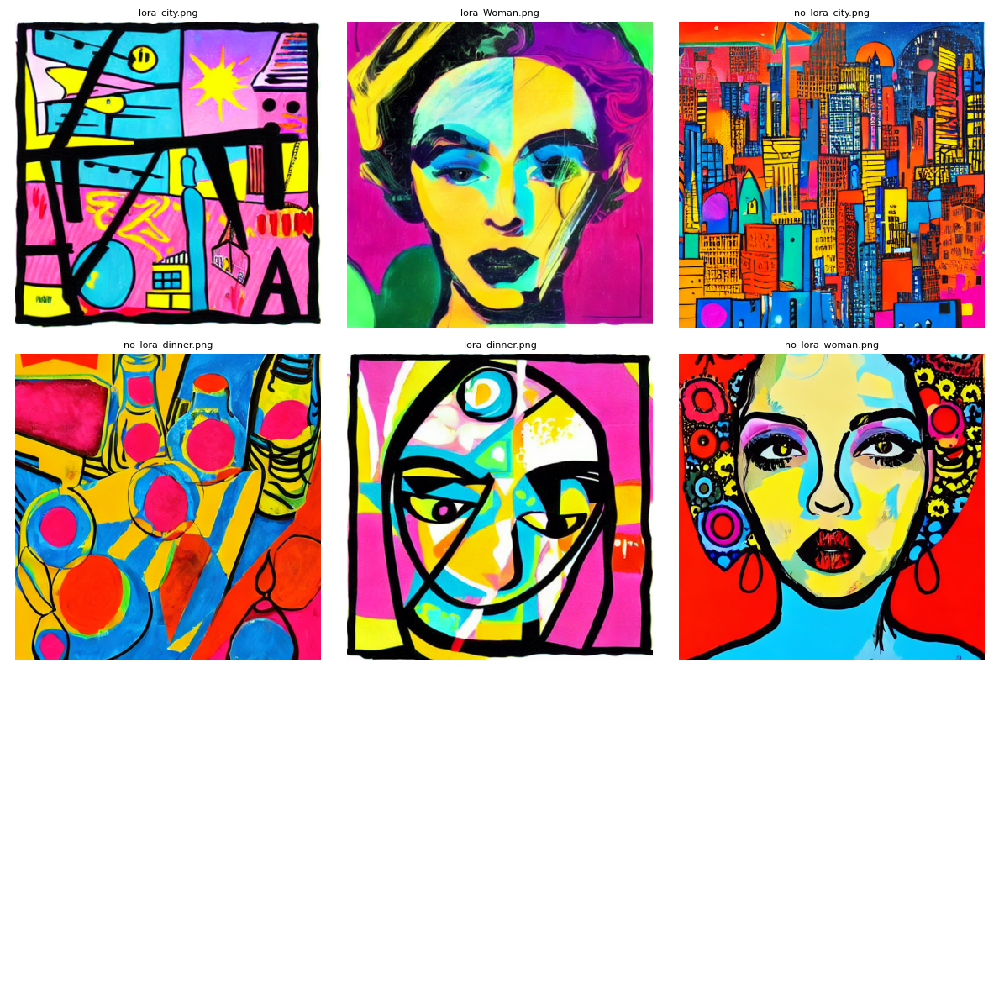

In [71]:
grid(paths_style[0])
grid(paths_style[1])
grid(paths_style[2])

CONTENT BASED PROMPTS <br>
<br/><br/>
Early-Renaissance:<br>
<br/><br/>
„A woman that lies in the arms of a man and cries under a tree of roses.“<br>
2„A pregnant woman that holds her belly and sits in the garden and dreams about a good world.“<br>
„A family that prays to god in the church, the light shines through a window on the family.“<br>
1„A family eats a lot of meat for dinner in a old living room of a renaissance building.<br>
„Christmas dinner.“

<br/><br/>
Expressionism:<br>
<br/><br/>
„A woman that knees on the floor bagging for money and crying for help, expressionism.“<br>
„Horses running through the streets of new york, expressionism“<br>
„A family eats meat for dinner every one seems to be depressed.“<br>

<br/><br/>
Pop-Art:<br>
<br/><br/>
„A woman flirting in a cute dress under the moonlight, pop art“<br>
„ The Eiffel tower, a couple in front of it, pop art “<br>
„A family eats meat for dinner, pop art“<br>
„A banana on the table, pop art“<br>

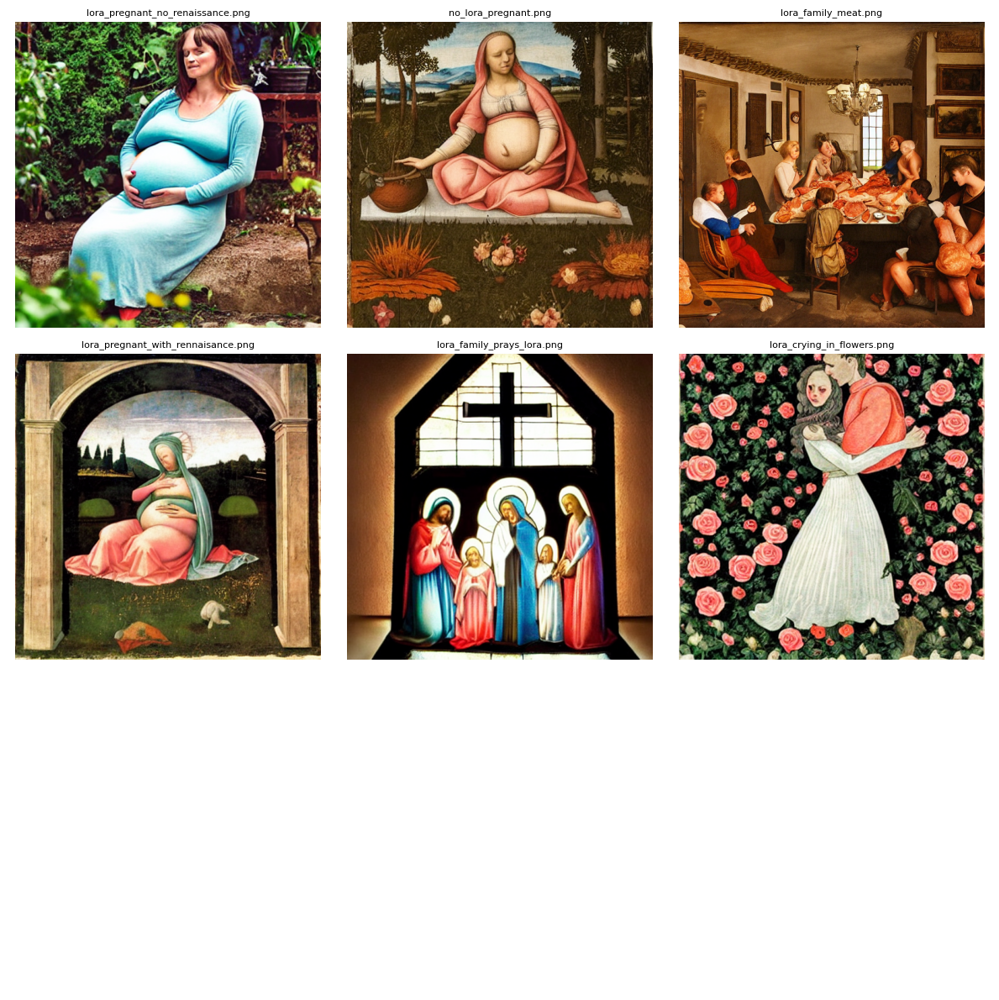

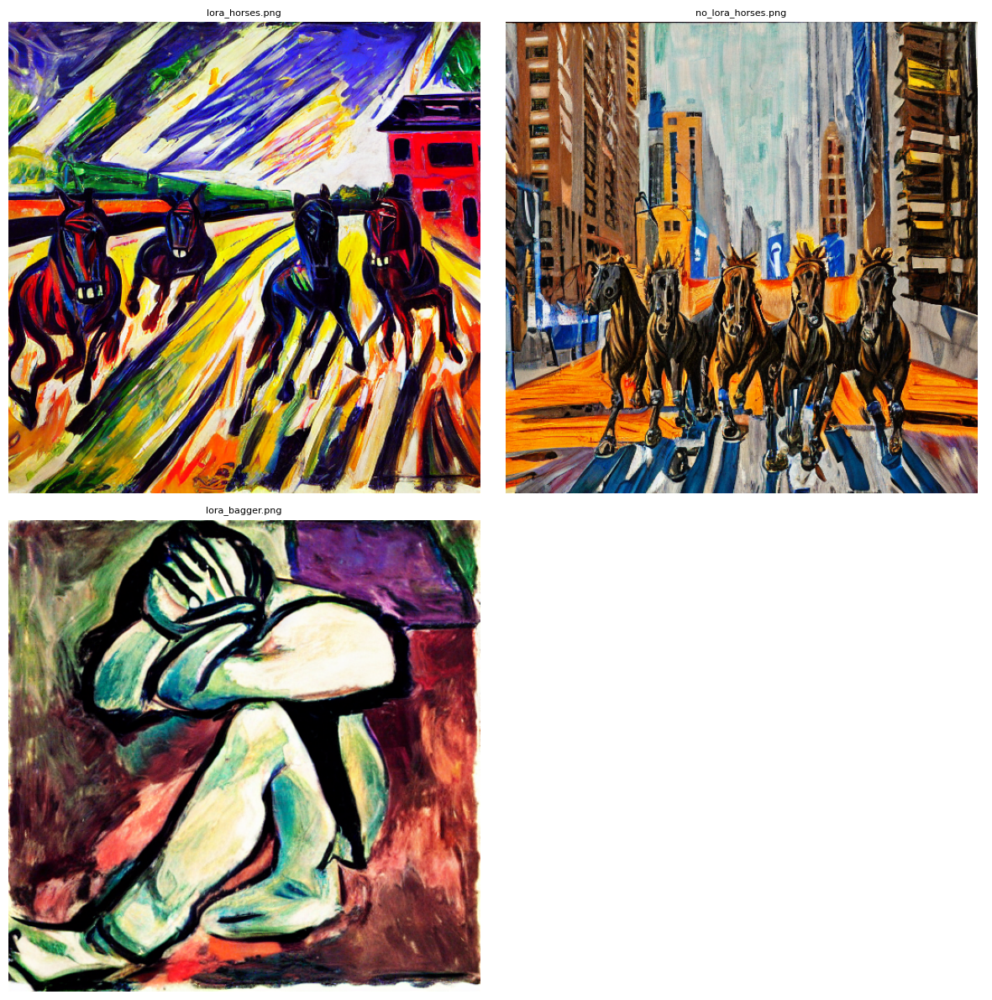

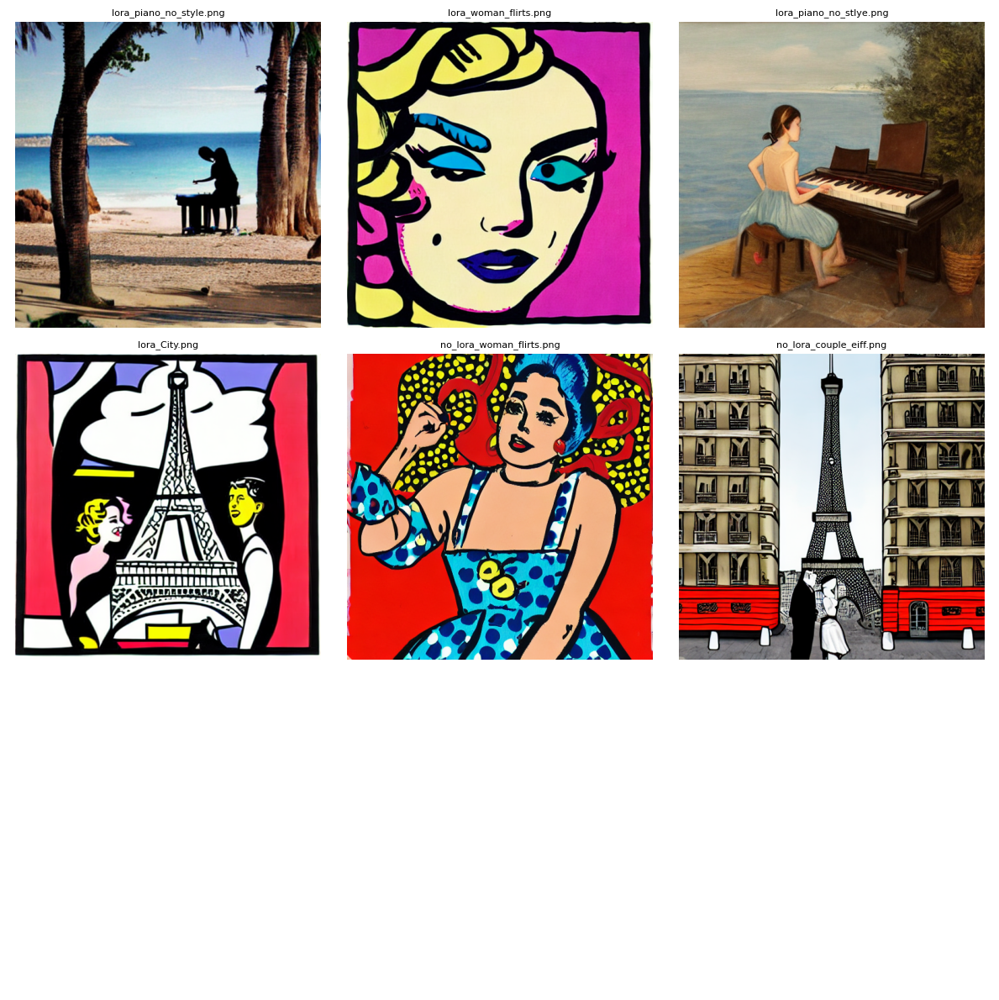

In [72]:
grid(paths_content[0])
grid(paths_content[1])
grid(paths_content[2])

EDGE CASES<br>
<br><br/>
„ A woman dances in the club, style.“<br>
„ A gunni pick flies to the moon, style.“<br>
„The moon crashes on the earth, style.“<br></br> 
For the each-cases we decided to take the same prompts for each art style to compare the results and see if there is a difference on the output quality. <br>
When the ouput image looked interesting we also kept the img without lora.


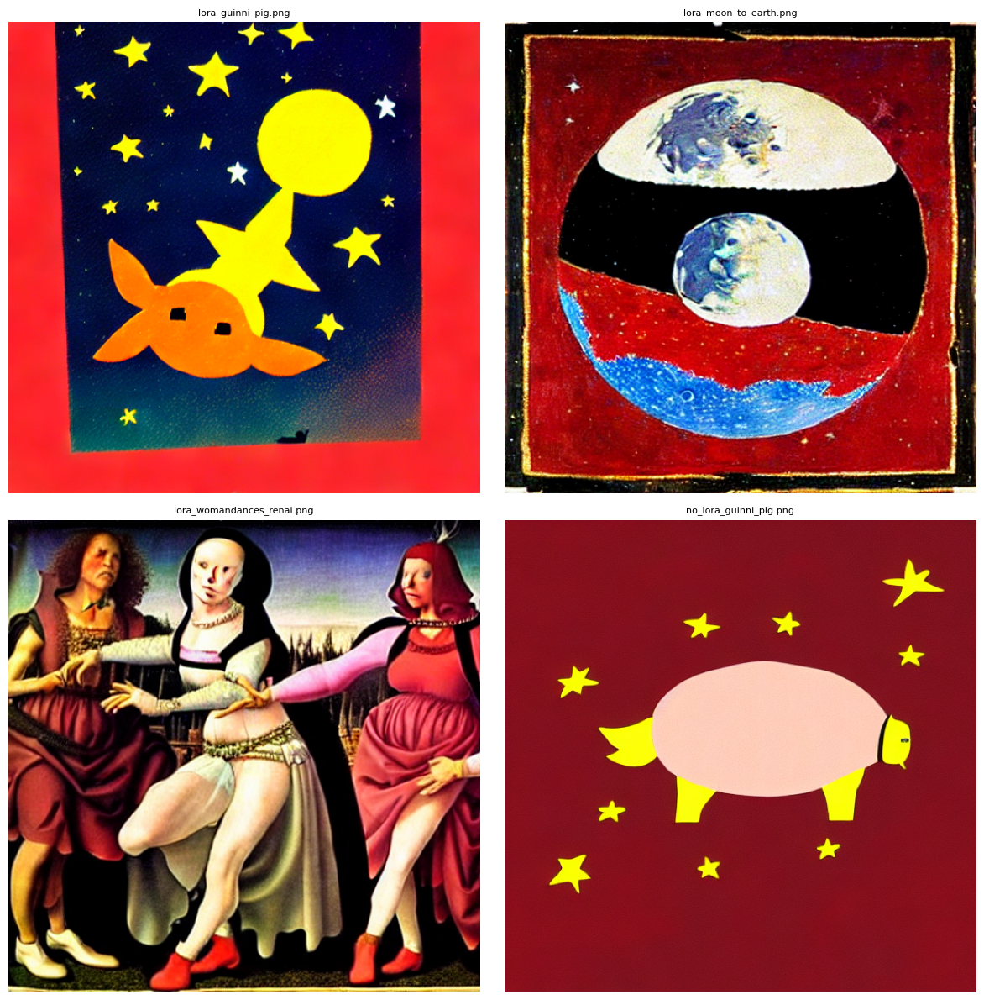

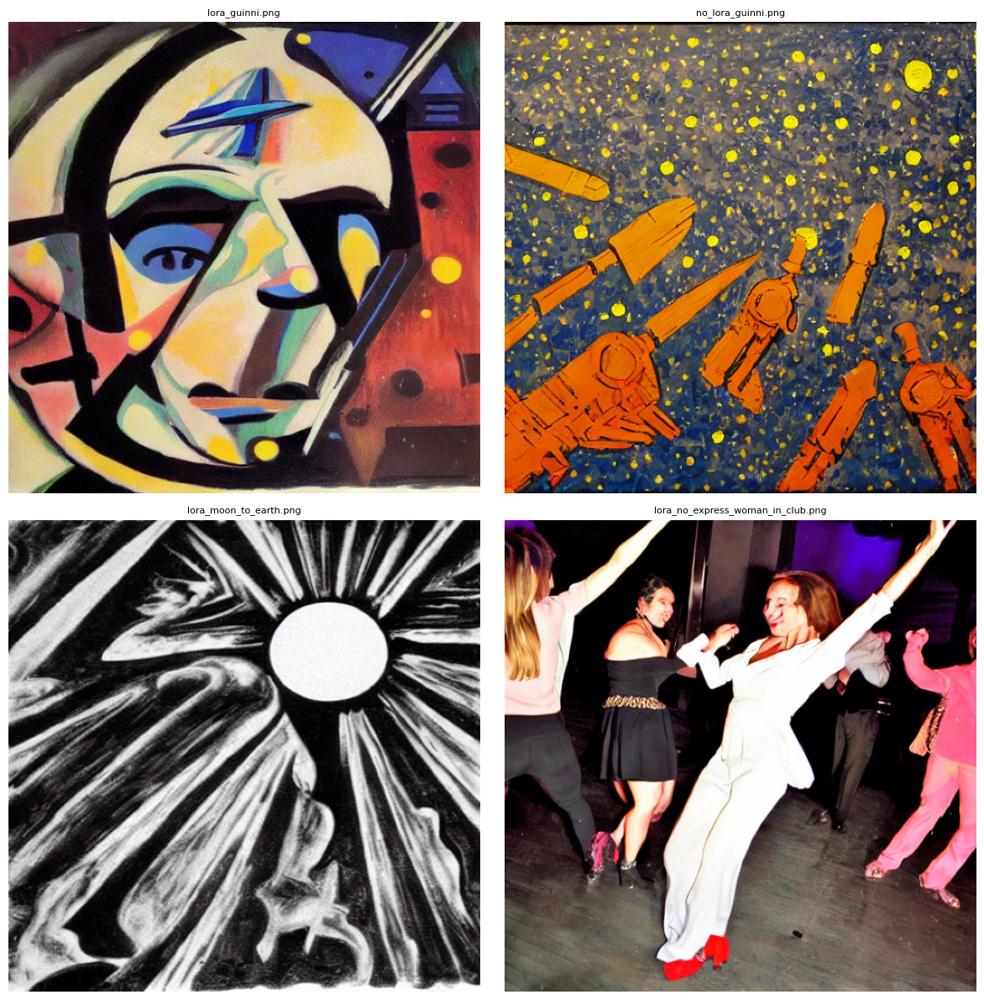

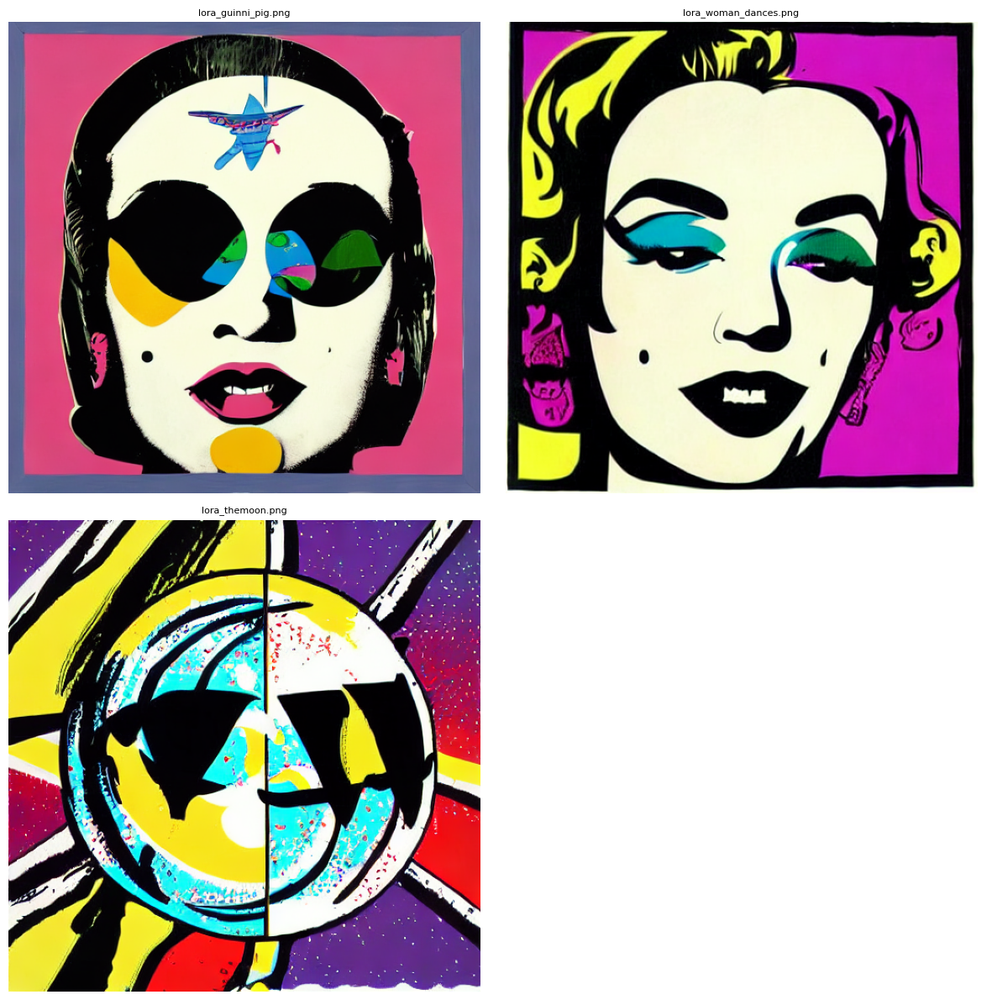

In [73]:
grid(paths_edge[0])
grid(paths_edge[1])
grid(paths_edge[2])

General 
num_inference_steps: 50 <br>
guidance_scale: 7 <br>
r: 16 <br>

- Sticks to the content <br>
- Not naming art style leads to normal photos without any style or random style <br>
- Far away faces are not good in renaissance<br>
- Art Pop loves Marilyn Monroe (kind of overfitted)<br>
<br></br>
Content Expressionism 

- LoRA is more close to the art styles than without, especially expressionism horses e.g. <br>
- Emotions are there (typical)<br>
- Sticks to Content from prompt <br>
<br></br>
Style Expressionism <br>
- Close to prompt - too serious in terms of colors and contrasts from prompts<br>
- Brush Strokes mixed up and dynamic , destroyed, emotional—> Typical for expressionism <br>
<br></br>
Edge Cases Expressionism<br>
- An astronaut but not really a Ginny Pic <br>
<br></br>
Style Art Pop <br>
- Bold Strokes, and Colors and looks really like Art Pop <br>
- Content, almost all women are Marilyn Monroe in loRA<br>
- Pretty abstract not really Details <br>
- Dinner is more or less Like a Face and not the family with and egg on  the Head 
<br></br>
Edge Art Pop 
Even the Ginny Pic is a Woman that looks like Marilyn Monroe <br>
Woman dances also —> all so Marilyn Monroe —> kind of overfitted her somehow<br>
<br></br>
Renaissance <br>
Style is typical Renaissance, but did not know the Black and Blue and Yellow that’s typical for Renaissance when we used the Colors in the prompt — way too much bold<br>
<br></br>
Content Renaissance <br>
- Faces from far away didn’t look good<br>
- Colors a Better because we did not name them <br>
- Transports emotions, people in images look worried<br>
- And sticks prompt <br>
<br></br>
Edge Case Renaissance <br>
- It can generate even a Ginny Pic!<br>
- Moon Loos like Renaissance style <br>


Qualitiy<br>
Okay, but not many details compared to original images<br></br>

Artifacts:<br>
Not really

We also tested seed 82 and r 4 <br>
 r 4 did not change the output with the test prompt too much<br>
 seed 82 changed color to very intense colors 